In [4]:
import tensorflow as tf
import PIL
import os
import keras.preprocessing.image as im
import matplotlib.pyplot as plt
import pandas as pd
import cv2
import numpy as np
from sklearn.preprocessing import LabelBinarizer
import keras.utils as image

In [5]:
traindir = r"C:\Users\2020d\AI\data handwriting\train_v2\train"
testdir = r"C:\Users\2020d\AI\data handwriting\test_v2\test"
ytrpd = pd.read_csv(r"C:\Users\2020d\AI\data handwriting\written_name_train_v2.csv", index_col = False)
ytepd = pd.read_csv(r"C:\Users\2020d\AI\data handwriting\written_name_test_v2.csv", index_col = False)
yvapd = pd.read_csv(r"C:\Users\2020d\AI\data handwriting\written_name_validation_v2.csv", index_col = False)
letterstr = "#$&123456789abcdefghijklmnopqrstuvwxyz"
training_set = []
val_set = []

In [6]:
train_datagen = im.ImageDataGenerator(rescale = 1./255,)
training_set = train_datagen.flow_from_directory(r"C:\Users\2020d\AI\alphabet-numeric\Train", target_size = (32, 32), batch_size = 32, class_mode = "categorical", color_mode ="grayscale")

Found 796027 images belonging to 38 classes.


In [7]:
val_set = train_datagen.flow_from_directory(r"C:\Users\2020d\AI\alphabet-numeric\Validation", target_size = (32, 32), batch_size = 32, class_mode = "categorical", color_mode ="grayscale")

Found 21274 images belonging to 38 classes.


In [8]:
print(val_set.class_indices)

{'#': 0, '$': 1, '&': 2, '1': 3, '2': 4, '3': 5, '4': 6, '5': 7, '6': 8, '7': 9, '8': 10, '9': 11, 'A': 12, 'B': 13, 'C': 14, 'D': 15, 'E': 16, 'F': 17, 'G': 18, 'H': 19, 'I': 20, 'J': 21, 'K': 22, 'L': 23, 'M': 24, 'N': 25, 'O': 26, 'P': 27, 'Q': 28, 'R': 29, 'S': 30, 'T': 31, 'U': 32, 'V': 33, 'W': 34, 'X': 35, 'Y': 36, 'Z': 37}


In [9]:
print(training_set.class_indices)

{'#': 0, '$': 1, '&': 2, '1': 3, '2': 4, '3': 5, '4': 6, '5': 7, '6': 8, '7': 9, '8': 10, '9': 11, 'A': 12, 'B': 13, 'C': 14, 'D': 15, 'E': 16, 'F': 17, 'G': 18, 'H': 19, 'I': 20, 'J': 21, 'K': 22, 'L': 23, 'M': 24, 'N': 25, 'O': 26, 'P': 27, 'Q': 28, 'R': 29, 'S': 30, 'T': 31, 'U': 32, 'V': 33, 'W': 34, 'X': 35, 'Y': 36, 'Z': 37}


In [10]:
cnn = tf.keras.models.Sequential()
cnn.add(tf.keras.layers.Conv2D(32, (3,3), padding = "same", activation = "relu", input_shape = (32, 32, 1)))
cnn.add(tf.keras.layers.MaxPooling2D(pool_size = (2, 2)))
cnn.add(tf.keras.layers.Conv2D(64, (3,3), activation = "relu"))
cnn.add(tf.keras.layers.MaxPooling2D(pool_size = (2, 2)))
cnn.add(tf.keras.layers.Conv2D(128, (3,3), activation = "relu"))
cnn.add(tf.keras.layers.MaxPooling2D(pool_size = (2, 2)))
cnn.add(tf.keras.layers.Dropout(0.25))
        
cnn.add(tf.keras.layers.Flatten())
cnn.add(tf.keras.layers.Dense(activation = "relu", units = 128))
cnn.add(tf.keras.layers.Dropout(0.2))
cnn.add(tf.keras.layers.Dense(activation = "softmax", units = 38))

In [11]:
cnn.compile(loss='categorical_crossentropy', optimizer="adam",metrics=['accuracy'])


In [12]:
cnn.fit(training_set, validation_data = val_set, epochs = 5, batch_size=32)

Epoch 1/5
24876/24876 [==============================] - 1069s 43ms/step - loss: 0.2916 - accuracy: 0.9067 - val_loss: 0.1998 - val_accuracy: 0.9410
Epoch 2/5
24876/24876 [==============================] - 957s 38ms/step - loss: 0.2043 - accuracy: 0.9326 - val_loss: 0.1882 - val_accuracy: 0.9450
Epoch 3/5
24876/24876 [==============================] - 950s 38ms/step - loss: 0.1931 - accuracy: 0.9358 - val_loss: 0.1832 - val_accuracy: 0.9397
Epoch 4/5
24876/24876 [==============================] - 943s 38ms/step - loss: 0.1866 - accuracy: 0.9379 - val_loss: 0.1682 - val_accuracy: 0.9485
Epoch 5/5
24876/24876 [==============================] - 955s 38ms/step - loss: 0.1843 - accuracy: 0.9387 - val_loss: 0.1863 - val_accuracy: 0.9423


In [6]:
cnn = tf.keras.models.load_model("Handwriting_AI.h5")

In [65]:
predictimg = image.load_img(r"C:\Users\2020d\Downloads\Unicode_0x0037.svg.png", target_size=(32, 32), color_mode="grayscale")
predictimg = np.invert(predictimg)
predictimg1 = image.img_to_array(predictimg)
predictimg1 = predictimg1 / 255
predictimg1 = np.expand_dims(predictimg1, axis = 0)
result = cnn.predict(predictimg1)
sorted_res = np.argsort(result)
print(letterstr[result.argmax()])
print(result.max())
print(letterstr[sorted_res[0][37]], letterstr[sorted_res[0][36]], letterstr[sorted_res[0][35]], letterstr[sorted_res[0][34]], letterstr[sorted_res[0][33]])
print(result[0][sorted_res[0][37]], result[0][sorted_res[0][36]],result[0][sorted_res[0][35]],result[0][sorted_res[0][34]],result[0][sorted_res[0][33]],)
print(result)

1/1 [==============================] - 0s 28ms/step
1
0.39301926
1 l i t c
0.39301926 0.3585525 0.14721079 0.015699651 0.010364558
[[3.11113735e-09 2.01042329e-08 5.66671048e-08 3.93019259e-01
  2.07362417e-03 5.27498087e-05 5.09077590e-03 1.41585735e-03
  5.65449987e-03 1.15721952e-03 1.24497456e-03 1.85232039e-03
  3.28504224e-03 1.21730263e-03 1.03645576e-02 1.26866763e-03
  4.37824754e-03 8.66962969e-03 3.24081513e-03 3.69677041e-03
  1.47210792e-01 1.45785033e-03 6.19322818e-05 3.58552486e-01
  1.15584415e-04 2.48746877e-03 3.50663066e-03 3.13269929e-03
  8.17666005e-04 5.74459461e-03 2.00463785e-03 1.56996511e-02
  5.93979796e-03 2.06753728e-03 1.25684383e-04 3.82796934e-05
  3.22365505e-03 1.30612068e-04]]


In [63]:
result[0][0]

2.3299582e-07

In [37]:
sorted_res

array([[ 0,  1,  2, 35, 22, 24, 34, 37, 25, 19,  5, 21, 15,  9, 13, 33,
        12, 29, 36, 32, 28,  4,  7, 30, 26, 27,  8,  6, 31, 18, 16, 11,
        14, 10, 17, 20, 23,  3]], dtype=int64)

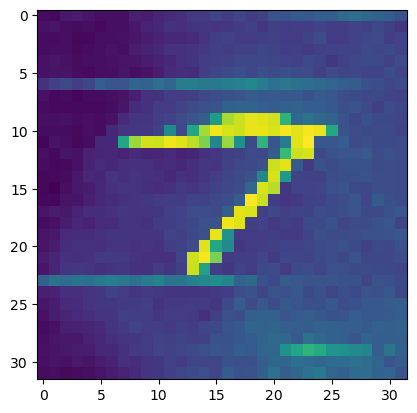

In [25]:
plt.imshow(predictimg)

In [34]:
print(result)

[[1.2338062e-05 3.8718686e-06 2.9954226e-06 4.2802554e-07 3.1952045e-06
  2.5432735e-06 3.2731232e-06 5.0414724e-06 1.7221037e-05 9.7134887e-07
  1.3346480e-05 9.7433031e-06 9.9758875e-01 6.4253365e-04 3.9938724e-04
  1.8453594e-06 1.5454418e-04 1.3029610e-04 7.8636021e-06 2.2273153e-04
  1.7918258e-06 4.3225177e-06 6.9553671e-06 1.1845240e-05 1.0128581e-07
  1.8123425e-04 4.8270977e-05 8.1264581e-05 5.2987190e-05 2.4833711e-04
  3.9398278e-06 9.2566061e-06 5.9970444e-06 2.7984599e-06 1.5103883e-05
  6.2382271e-05 3.6977758e-07 3.6069261e-05 4.0987616e-06]]


In [16]:
cnn.save("Handwriting_AI_4.h5")

<Figure size 640x480 with 0 Axes>

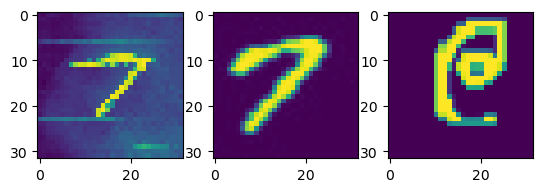

In [107]:
plt.figure()
f, readimg = plt.subplots(1,3)
readimg[0].imshow(predictimg)
readimg[1].imshow(xabc)
readimg[2].imshow(abcde)


In [10]:
defg = np.arange(1, 10)
defg

array([1, 2, 3, 4, 5, 6, 7, 8, 9])

In [14]:
defg = defg/255
defg

array([0.00392157, 0.00784314, 0.01176471, 0.01568627, 0.01960784,
       0.02352941, 0.02745098, 0.03137255, 0.03529412])

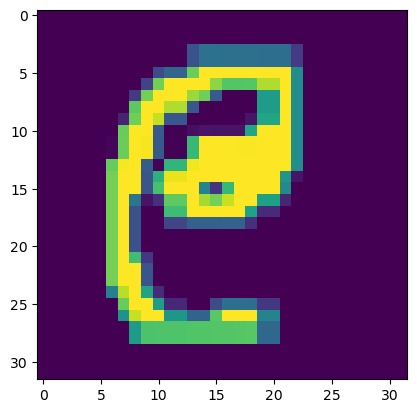

In [91]:
predictimg = image.load_img(r"C:\Users\2020d\AI\alphabet-numeric\Train\@\___11_7085733.png", target_size=(32, 32), color_mode="grayscale")
plt.imshow(predictimg)

In [ ]:
LB = LabelBinarizer()
Y_train = LB.fit_transform(Y_train.astype(str))

In [61]:
X_train = []
Y_train = []
for i in os.listdir(traindir):
    sub_dir = os.path.join(traindir, i)
    temp = cv2.imread(sub_dir)
    temp = cv2.resize(temp, (32, 32))
    temp = np.reshape(temp, (32, 32, 3))
    X_train.append(temp)
    print(sub_dir)
#     print(temp, "," ,sub_dir)
    
# print(X_test)

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00015.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00192.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00414.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00659.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00815.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_00978.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01130.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01392.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01526.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01665.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_01916.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02056.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02204.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02356.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02527.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02710.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_02890.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03053.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03306.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03522.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03758.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_03982.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04265.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04432.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04571.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04698.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_04863.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05071.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05217.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05376.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05623.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05767.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_05919.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06096.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06247.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06382.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06587.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06588.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06596.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06737.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_06863.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07045.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07251.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07406.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07562.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07712.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_07880.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08141.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08276.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08510.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08655.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08814.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_08956.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09107.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09240.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09409.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09604.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09784.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_09965.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100126.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10028.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100447.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100631.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_100789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10079.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101033.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101191.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101343.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101516.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101667.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101814.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_101958.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102115.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102260.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102379.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102519.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102667.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102828.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_102971.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103124.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103283.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10344.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103581.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103705.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103855.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_103999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10400.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104162.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10432.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104469.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104622.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104761.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_104920.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105076.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105227.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10535.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105578.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105701.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_105917.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106039.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106197.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106355.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106503.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106636.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106779.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_106934.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107104.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107258.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107404.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107535.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107670.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107818.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_107960.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108202.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108347.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108465.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108610.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108755.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_108904.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109063.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109198.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109364.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109533.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109692.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10987.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_10998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_109985.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110125.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110283.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110449.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110602.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110771.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_110935.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111083.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111291.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111431.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11158.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111734.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_111925.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112077.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112218.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112341.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112506.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112682.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_112847.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113012.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113151.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113299.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113455.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113603.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113761.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_113953.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114162.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114296.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114436.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114578.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114711.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114849.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_114988.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115139.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115298.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115453.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115605.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115770.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_115938.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116093.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116222.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116393.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116550.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116702.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116860.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_116982.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117123.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117284.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117429.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117573.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117708.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117846.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_117999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11800.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11817.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118315.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118465.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118610.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118755.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_118884.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119026.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119177.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119324.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119494.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119630.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119784.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_119939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_11994.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120103.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120246.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120393.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120531.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120667.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120811.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_120964.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121129.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121264.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121419.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121567.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121706.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121819.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_121970.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122116.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122267.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122412.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122575.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122721.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_122879.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123040.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123188.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123326.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12347.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123629.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123799.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_123945.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124090.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124244.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124397.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124526.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124646.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124761.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_124924.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125086.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125257.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125422.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125571.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125741.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12588.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_125892.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126039.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126197.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126320.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126480.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126654.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126815.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_126930.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12707.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127224.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127377.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127548.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127707.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_127929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12793.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128176.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12832.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128475.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128622.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128767.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_128924.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129092.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129251.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129411.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129554.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12969.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_12985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_129859.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130013.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130181.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13034.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130587.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130588.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130595.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130752.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_130913.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131079.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131249.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131396.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131542.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131677.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131803.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_131937.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132067.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132192.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132310.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132457.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132601.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132754.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_132917.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133074.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133234.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133390.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133558.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13370.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133848.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_133989.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134114.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134227.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134344.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134581.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134711.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134831.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_134959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13496.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135106.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13522.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135334.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135448.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13556.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135704.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135858.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_135989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13599.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136127.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136248.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136366.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136492.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136626.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13676.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_136884.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137040.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137187.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137317.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137432.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137587.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137588.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137596.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13776.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_137959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13796.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138118.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138350.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138476.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138681.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_138911.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139161.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139287.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139512.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139743.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_139859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_13986.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14003.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140193.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140338.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140565.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140749.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_140909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14091.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141085.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141287.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141404.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141536.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141709.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141863.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_141990.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142110.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142257.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142400.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14257.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142723.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_142899.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14310.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143215.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14334.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14357.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143710.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143848.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_143999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144005.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144135.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144357.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144517.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144720.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14489.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_144999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145007.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145137.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145283.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145431.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145672.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145844.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_145998.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146158.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146287.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146454.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146609.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146753.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_146900.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14707.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147227.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147384.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147534.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147713.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_147899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14790.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148034.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148161.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148316.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148461.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148619.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148792.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_148942.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149148.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149366.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149478.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149623.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149747.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_14988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149880.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_149999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150010.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150129.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150258.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15039.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150515.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150648.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150819.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_150991.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151108.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151232.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151443.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151582.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151706.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_151830.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152060.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152243.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152469.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152699.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152840.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_152971.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153113.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153255.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153380.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153505.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153654.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153815.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_153967.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154104.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154222.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154372.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154517.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154676.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154829.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_154991.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15515.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155324.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155490.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155661.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155828.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_155996.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156170.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156337.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156497.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156661.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156827.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_156989.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157152.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15732.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157472.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157636.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157803.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_157946.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15810.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158264.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158414.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158556.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158693.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158826.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_158967.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159109.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159232.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159373.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159502.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159632.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159760.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_15988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159885.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_159999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160004.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160147.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160285.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160416.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160547.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160666.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160791.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_160910.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161055.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161193.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161333.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161478.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161631.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161792.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_161966.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162110.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162262.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16241.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162547.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162676.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162829.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_162970.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163121.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163276.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163421.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163563.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163702.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163866.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_163999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16401.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164244.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164390.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164559.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164715.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_164874.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165019.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165169.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165314.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165447.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165585.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165708.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165847.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_165961.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16612.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166258.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166393.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166538.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166665.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_166808.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167021.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167163.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16732.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167460.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167611.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167748.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_167877.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168027.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16818.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168332.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168499.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168641.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168782.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_168927.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169083.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169239.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169399.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169538.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169687.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_16984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169849.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_169999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170010.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170162.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170309.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170471.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170639.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170789.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_170910.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171054.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17120.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171358.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17151.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171648.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171788.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_171922.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172059.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172189.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17232.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172451.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172583.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172721.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172853.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_172979.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173104.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173242.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173374.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173507.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173642.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173787.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_173921.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174050.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174167.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174287.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174413.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174550.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174681.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174804.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_174927.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175076.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175209.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175348.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175523.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17567.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175828.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_175980.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176130.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176289.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176448.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176587.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176588.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176595.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176744.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_176898.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177053.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177207.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177362.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177515.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177663.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177812.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_177967.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178110.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17825.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178369.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178519.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17865.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_178889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17889.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179023.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179165.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179289.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179418.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179539.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179665.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179787.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_17991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_179914.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180048.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180170.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180295.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180419.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180554.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180672.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180785.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_180907.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181036.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181158.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181296.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181432.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181587.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181744.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_181900.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18206.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182219.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182383.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182533.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182689.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182845.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_182999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183009.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183159.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183303.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183457.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183614.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183767.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_183915.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184077.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184229.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18438.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184536.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184692.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184836.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_184987.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18513.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185292.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185430.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185571.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185706.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185830.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_185980.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186125.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186288.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186442.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186576.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186701.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186841.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_186979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18698.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187118.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187240.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187370.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187517.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187648.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187792.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_187931.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188103.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188280.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188405.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188548.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188750.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_188900.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189064.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189241.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189405.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189563.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189755.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_18998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_189981.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190126.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190250.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190408.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190640.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190817.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_190947.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191095.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191239.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191467.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191587.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191588.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191590.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19175.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_191866.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192053.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192198.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192389.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192506.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192659.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192831.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_192988.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193141.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193278.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193439.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193608.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193754.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_193898.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194059.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194247.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19440.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194522.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194756.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194872.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_194995.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195142.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19530.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195464.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195621.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195782.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_195918.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196066.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196203.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196379.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196556.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196716.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_196892.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197048.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197206.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197355.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197521.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197746.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_197906.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198068.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198233.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198400.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198559.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198711.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_198857.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199029.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199171.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199327.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199496.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199656.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199805.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_19996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_199962.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200119.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200282.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200443.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20061.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200777.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_200937.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201105.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20127.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201443.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201588.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201600.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201755.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_201900.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202039.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20219.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202358.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202516.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202700.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_202868.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203037.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203195.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203356.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20352.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203686.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203835.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_203972.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204104.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204239.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204388.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204548.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204697.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204852.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_204991.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205131.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205285.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205422.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205545.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205698.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205839.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_205966.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206104.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20623.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206377.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206525.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206662.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206824.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_206965.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207112.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207270.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207439.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207604.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207755.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_207922.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20810.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208275.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208451.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208619.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208788.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_208952.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209097.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209254.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209416.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209587.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209741.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_20990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_209906.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210062.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21024.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21041.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210570.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210738.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_210904.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211062.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21123.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21139.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21163.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211794.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_211923.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21207.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212213.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212357.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212514.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212657.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212806.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_212960.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213076.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213211.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213341.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213480.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213608.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213733.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213854.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_213993.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214212.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214369.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214512.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214641.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214771.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_214906.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215050.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215198.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215359.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215513.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215673.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215822.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_215987.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216151.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216327.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216498.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216668.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216834.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_216965.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217099.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217219.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217339.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217468.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217603.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217773.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_217946.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218089.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21823.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21836.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21851.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218644.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218796.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_218950.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219105.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219253.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219419.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21957.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219712.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219846.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_21998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_219988.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220129.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220245.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220498.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220643.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220780.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_220929.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221071.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221223.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221381.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221526.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221684.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221819.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_221967.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222121.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222292.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222458.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222623.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222787.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_222961.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223131.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223302.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223478.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223655.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223820.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_223987.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224121.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224263.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224391.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224534.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22468.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224829.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_224992.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225149.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225297.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225425.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225566.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225719.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22587.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_225873.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226037.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226187.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226333.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226447.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226584.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226706.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226853.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_226965.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22708.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227199.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227339.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227484.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227645.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227795.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_227968.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228106.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228219.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228345.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228463.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228575.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228721.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228868.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_228999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229011.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229142.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229296.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229454.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229605.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229758.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_22992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_229920.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230096.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230240.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230383.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230517.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230668.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230813.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_230953.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23109.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231226.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231379.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231526.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23167.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_231895.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232111.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232226.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232373.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232526.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232684.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232825.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_232980.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233117.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233266.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233462.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233637.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233801.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_233974.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234118.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234269.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234436.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234604.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234769.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_234948.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235118.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235293.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235492.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235670.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235836.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_235999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236007.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236170.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236337.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236492.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236671.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236823.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_236991.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237148.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237308.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237447.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237587.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237588.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237597.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237749.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_237890.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238035.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238174.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238325.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238479.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23861.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238744.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_238883.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239023.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239176.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239323.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239447.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239576.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239709.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239856.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_23999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_239999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240001.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240158.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240297.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240437.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240587.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240732.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_240883.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241041.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241203.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241371.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24154.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241710.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_241875.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242060.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242233.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242401.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242567.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24273.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_242905.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243071.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243234.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243394.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243570.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243727.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_243880.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244021.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244173.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244348.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244515.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244668.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244820.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_244969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24497.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245114.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245260.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24541.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245557.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245718.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24587.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_245999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246002.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246135.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246279.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246426.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246568.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246716.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24685.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_246984.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247115.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247249.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247386.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247531.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247678.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247817.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_247969.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248146.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24831.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248483.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248646.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248823.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_248988.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249153.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249306.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249470.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249641.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249811.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_24999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_249992.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250149.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250308.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250484.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250640.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250802.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_250969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25097.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251129.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251295.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251464.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251614.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251770.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_251916.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252068.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252217.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252362.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252506.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252646.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252787.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_252917.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253069.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253230.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253367.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253515.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253662.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253809.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_253948.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254086.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254232.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254369.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25450.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254651.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254788.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_254931.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255072.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255206.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255338.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255494.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255656.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255821.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_255972.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256135.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256283.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256456.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256629.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256794.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_256960.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257118.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257280.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257447.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257601.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257772.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_257933.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258093.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258256.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25841.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258579.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258735.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_258887.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259033.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259160.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259281.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25941.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259540.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259683.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259816.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_25995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_259957.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260186.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260359.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260537.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260743.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260855.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_260973.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261087.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261206.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261335.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261447.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261568.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261709.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261854.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_261999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262003.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262151.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262291.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262442.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262578.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262700.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_262868.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263031.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263194.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263352.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263520.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263671.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26384.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_263994.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26417.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264334.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264495.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264647.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264796.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_264920.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265047.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265182.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265304.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265456.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265587.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265588.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265592.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265728.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26587.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_265987.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266123.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266243.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266370.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266519.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266642.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266774.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_266904.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267023.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267146.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267267.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26739.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267520.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267659.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26779.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_267927.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268080.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268237.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268385.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268536.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268686.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268848.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_268999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269011.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269178.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269339.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269502.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269653.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269808.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_26997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_269976.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270134.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270294.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270453.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270614.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270772.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_270922.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271081.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271244.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271394.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271558.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271712.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271860.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_271999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272000.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272126.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272290.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272439.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272575.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272719.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272850.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_272990.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27313.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273259.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273400.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273535.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273669.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273787.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_273904.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274017.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274240.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274365.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274508.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274649.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274790.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_274935.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275082.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275224.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275388.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27555.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275714.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_275869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27587.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276027.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276183.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276355.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276513.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276670.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27683.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_276977.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277134.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277297.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277432.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277571.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277719.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_277864.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278035.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278196.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278352.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278514.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278677.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278837.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_278982.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279123.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279278.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279401.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279542.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279667.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_27987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_279871.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280012.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280166.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280300.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280431.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280550.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280684.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280813.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_280944.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281068.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281199.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281338.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281487.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281623.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281789.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_281951.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282124.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282292.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282461.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282602.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282774.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_282944.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283115.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283276.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283438.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283607.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283775.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_283943.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28411.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284271.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284435.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284602.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284758.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_284923.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285087.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285247.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285415.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285574.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285741.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285867.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_285999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286009.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286156.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286297.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286445.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286587.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286588.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286598.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286738.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_286890.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28709.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287221.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287364.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287513.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287665.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28780.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_287946.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288084.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288222.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28837.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288510.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288732.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_288965.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289114.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28926.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289420.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289581.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289741.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_28991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_289917.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290086.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290250.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290414.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290568.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290736.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_290907.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291076.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291243.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291400.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291565.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291722.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_291966.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292105.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29226.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292408.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292616.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292747.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_292875.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293042.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29319.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293334.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293501.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293618.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293795.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_293933.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294072.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29427.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294384.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294512.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294651.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_294869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29487.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295047.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295202.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295358.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295527.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295692.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_295859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29586.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29602.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296176.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296343.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296510.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296670.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296838.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_296999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297010.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297191.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297356.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297495.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297630.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297765.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_297902.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298064.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298204.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298327.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298453.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298580.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298694.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298814.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_298930.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299049.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299201.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299327.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299457.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299626.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299748.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_299869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_29987.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300096.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300240.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300414.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300576.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300738.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_300896.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301060.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301213.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30136.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301519.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30168.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301858.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_301999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302006.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302159.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302299.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30245.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302606.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302759.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_302909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30291.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303055.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303202.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303342.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303487.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303652.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303802.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_303945.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304090.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30425.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304416.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304575.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304735.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_304890.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305135.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305291.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30545.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305663.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305817.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_305965.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306124.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306278.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306426.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306572.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306727.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_306865.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307017.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307150.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307312.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307443.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307568.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307757.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_307895.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308079.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308320.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308474.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308611.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308770.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_308926.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309060.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309191.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309335.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309504.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309651.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309821.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_30999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_309992.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310163.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310324.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310470.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310640.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310773.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_310909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31091.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311044.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311260.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311427.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311567.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311705.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_311905.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312048.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312175.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31229.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312416.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312543.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312710.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_312864.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313012.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313158.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313304.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313451.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313587.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313588.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313592.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313732.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_313881.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31403.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314182.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314364.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314503.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314657.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314809.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_314956.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315127.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315290.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315441.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315605.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31576.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_315926.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316086.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316242.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316362.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316529.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316672.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31679.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_316998.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317116.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31727.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317422.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317627.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317786.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_317933.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318098.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318266.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318404.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318527.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318668.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_318874.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31906.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319187.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319347.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319584.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319733.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_31987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_319879.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320021.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320192.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32036.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320503.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320627.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320740.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_320886.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321020.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32116.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321295.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321469.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321613.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321793.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_321919.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322055.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322198.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32234.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322480.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322637.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32280.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_322950.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323086.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323220.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323364.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323511.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323649.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323800.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_323947.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324094.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324242.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324386.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324521.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324666.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324783.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_324919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32492.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325070.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325208.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325354.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325494.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325659.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325820.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_325995.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326163.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326321.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326451.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326621.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32679.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_326951.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327113.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327269.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327433.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327588.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327600.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32775.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_327904.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328060.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328221.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328383.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328551.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328713.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328864.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_328999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329002.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32914.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329281.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329431.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329587.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329588.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329720.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_32987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_329871.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33012.j

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330265.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330399.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330534.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330648.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330798.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_330953.

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33242.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33444.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33697.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33837.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_33984.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34123.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34277.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34462.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34646.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34820.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_34999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35000.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35185.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35367.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35551.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35732.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_35933.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36111.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36293.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36473.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36654.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36827.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_36992.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37172.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37326.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37509.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37684.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_37855.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38023.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38181.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38344.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38520.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38680.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38848.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_38999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39009.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39175.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39322.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39475.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39637.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39797.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_39969.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40122.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40263.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40401.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40536.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40672.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40811.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_40943.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41107.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41276.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41424.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41577.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41735.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_41889.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42052.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42204.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42360.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42540.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42722.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_42905.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43089.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43266.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43432.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43603.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43780.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_43957.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44144.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44329.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44501.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44680.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_44848.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45031.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45221.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45393.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45578.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45758.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_45940.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46117.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46296.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46480.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46663.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46821.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_46971.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47225.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47351.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47488.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47621.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47783.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_47949.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48092.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48251.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48405.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48560.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48707.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48847.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_48988.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49145.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49294.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49452.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49617.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49756.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49766.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_49922.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50069.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50224.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50391.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50573.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50749.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50894.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50895.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_50897.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51077.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51250.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51433.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51616.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51791.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_51988.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52165.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52351.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52524.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52697.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_52886.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53052.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53053.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53054.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53055.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53056.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53057.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53065.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53230.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53231.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53232.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53234.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53405.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53581.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53748.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_53919.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54094.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54258.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54413.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54568.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54702.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54703.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54704.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54705.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54706.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54707.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54708.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54709.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54710.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54711.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54712.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54713.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54714.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54715.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54857.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_54999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55002.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55151.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55308.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55460.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55614.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55771.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_55915.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56049.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56301.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56450.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56596.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56597.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56608.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56746.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56747.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56748.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56749.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56750.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56751.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56752.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56753.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56754.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56755.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56756.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_56914.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57058.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57059.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57060.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57061.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57062.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57072.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57215.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57352.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57503.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57663.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57816.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_57967.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58147.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58318.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58319.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58320.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58321.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58322.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58323.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58324.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58329.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58513.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58694.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58857.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58858.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58859.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58860.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58861.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58862.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58863.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58864.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58865.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58866.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58867.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_58868.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59033.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59214.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59397.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59575.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59744.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59896.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59897.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59898.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59899.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_59910.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60094.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60277.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60452.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60454.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60617.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60618.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60619.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60620.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60621.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60626.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60790.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_60966.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61160.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61312.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61453.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61454.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61455.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61467.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61612.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61773.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_61919.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62079.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62266.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62408.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62563.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62687.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62700.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_62846.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63046.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63195.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63345.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63507.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63655.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63814.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_63959.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64113.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64278.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64433.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64587.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64588.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64591.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64737.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_64888.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65037.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65188.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65348.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65506.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65670.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_65847.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66017.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66191.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66369.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66519.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66660.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66661.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66672.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66829.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_66983.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67121.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67258.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67380.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67381.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67386.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67522.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67775.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_67929.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68081.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68233.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68234.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68235.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68247.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68404.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68559.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68560.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68561.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68562.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68563.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68564.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68565.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68566.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68567.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68568.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68569.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68841.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_68999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69013.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69186.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69358.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69518.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69524.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69679.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69842.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_69999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70005.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70162.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70315.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70316.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70317.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70318.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70481.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70637.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70886.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70887.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70888.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70889.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70890.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70891.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70892.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70893.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_70894.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71051.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71052.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71191.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71192.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71193.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71194.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71195.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71351.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71509.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71658.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71659.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71660.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71803.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_71948.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72106.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72257.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72259.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72398.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72399.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72400.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72401.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72405.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72537.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72684.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72825.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72969.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72970.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_72971.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73119.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73250.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73251.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73252.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73253.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73254.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73255.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73256.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73257.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73396.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73397.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73398.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73541.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73788.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73966.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73967.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73968.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_73969.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74140.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74313.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74314.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74315.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74492.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74640.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74817.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74985.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_74990.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75162.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75287.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75440.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75598.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75599.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75600.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75601.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75602.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75612.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75773.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_75937.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76109.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76286.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76470.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76643.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76808.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_76963.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77134.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77299.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77450.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77584.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77585.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77586.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77587.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77588.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77589.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77590.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77591.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77592.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77593.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77594.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77595.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77596.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77740.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_77946.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78084.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78211.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78356.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78475.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78476.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78485.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78662.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78676.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78900.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_78914.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79041.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79180.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79341.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79512.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79513.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79514.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79515.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79516.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79517.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79518.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79681.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79835.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79836.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_79843.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80005.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80006.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80007.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80008.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80019.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80189.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80374.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80375.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80376.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80377.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80378.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80379.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80380.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80544.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80555.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80734.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80901.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80902.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80903.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80904.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_80915.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81103.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81105.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81274.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81275.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81435.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81583.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81835.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_81999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82004.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82005.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82167.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82168.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82169.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82177.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82365.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82534.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82535.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82536.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82537.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82538.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82539.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82540.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82541.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82542.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82543.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82544.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82715.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82729.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82868.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82869.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82870.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82871.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_82882.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83028.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83029.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83030.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83031.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83032.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83033.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83034.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83035.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83036.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83039.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83187.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83188.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83189.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83190.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83191.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83344.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83355.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83506.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83641.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83775.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_83925.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84083.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84195.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84196.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84197.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84198.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84209.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84345.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84346.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84359.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84502.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84642.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84771.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84772.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84773.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_84782.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85023.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85024.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85025.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85026.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85027.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85028.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85152.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85161.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85290.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85427.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85663.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85664.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85665.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85666.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85667.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85668.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85669.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85670.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85671.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85672.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85677.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85804.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_85934.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86185.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86299.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86300.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86301.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86302.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86303.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86304.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86305.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86306.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86307.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86308.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86309.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86310.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86311.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86312.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86313.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86437.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86448.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86584.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86736.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86737.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86738.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86739.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86740.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86741.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86742.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86743.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86744.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86745.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86746.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_86927.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87101.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87102.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87103.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87258.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87259.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87272.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87429.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87430.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87431.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87432.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87433.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87434.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87435.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87436.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87437.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87617.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87774.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87775.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87776.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87777.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87778.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87779.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87780.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87781.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87782.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87788.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_87959.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88118.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88119.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88120.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88121.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88122.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88123.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88124.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88125.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88130.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88275.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88276.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88277.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88278.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88279.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88280.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88281.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88282.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88289.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88472.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88647.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88820.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88822.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_88999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89002.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89003.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89004.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89184.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89185.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89186.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89187.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89347.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89348.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89349.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89350.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89351.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89352.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89361.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89533.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89534.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89688.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89689.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89690.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89691.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89692.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89693.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89694.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89695.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89696.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89697.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89698.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89699.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89700.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89701.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89702.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89851.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89852.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89853.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89854.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89855.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89856.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_89857.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90009.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90010.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90011.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90012.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90013.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90014.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90015.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90016.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90017.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90018.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90019.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90020.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90021.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90022.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90023.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90170.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90171.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90172.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90173.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90174.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90175.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90176.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90177.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90178.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90179.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90180.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90181.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90182.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90183.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90184.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90339.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90340.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90341.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90342.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90343.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90344.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90477.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90478.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90479.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90480.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90481.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90482.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90483.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90484.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90485.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90486.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90487.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90488.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90489.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90490.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90491.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90645.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90800.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90801.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90802.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90803.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90804.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90805.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90808.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_90943.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91077.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91078.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91091.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91213.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91214.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91215.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91225.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91382.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91383.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91384.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91385.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91386.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91387.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91388.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91389.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91390.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91391.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91392.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91393.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91394.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91395.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91396.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91519.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91520.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91521.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91522.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91523.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91524.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91525.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91526.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91527.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91528.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91529.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91530.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91531.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91532.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91533.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91673.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91674.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91675.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91676.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91677.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91678.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91679.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91680.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91681.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91682.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91683.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91684.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91685.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91686.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91687.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91821.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91822.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91823.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91824.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91825.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91826.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91827.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91828.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91829.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91830.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91831.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91832.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91833.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91834.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91835.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91971.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91972.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91973.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91974.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91975.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91976.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91977.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91978.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91979.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91980.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91981.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91982.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91983.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91984.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_91985.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92126.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92127.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92128.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92129.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92130.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92131.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92132.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92133.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92134.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92135.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92136.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92137.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92140.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92283.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92284.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92297.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92456.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92457.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92458.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92459.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92460.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92470.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92622.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92623.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92624.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92625.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92626.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92627.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92628.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92629.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92630.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92631.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92632.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92636.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92783.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92784.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92785.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92797.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92954.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92955.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92956.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92957.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92958.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92959.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92960.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92961.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92962.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92963.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92964.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92965.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_92966.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93104.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93105.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93106.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93107.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93108.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93109.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93110.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93111.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93112.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93113.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93114.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93115.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93116.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93117.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93118.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93274.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93416.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93417.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93418.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93419.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93420.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93421.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93422.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93423.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93424.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93425.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93426.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93427.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93428.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93429.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93583.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93584.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93837.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93838.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93839.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93840.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93841.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93842.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93843.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93844.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93845.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93846.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93847.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93848.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93849.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93850.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93851.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93986.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93987.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_93999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94000.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94138.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94139.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94140.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94141.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94142.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94143.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94144.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94145.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94146.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94147.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94148.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94149.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94150.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94151.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94152.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94285.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94286.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94287.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94288.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94289.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94290.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94291.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94292.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94293.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94294.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94295.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94296.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94297.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94298.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94299.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94461.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94462.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94463.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94464.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94465.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94466.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94467.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94468.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94469.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94470.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94471.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94472.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94473.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94474.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94475.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94633.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94634.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94635.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94636.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94637.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94638.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94639.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94640.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94641.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94642.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94647.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94806.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94807.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94808.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94809.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94810.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94811.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94812.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94813.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94814.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94815.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94816.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94817.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94818.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94819.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94820.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94988.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94989.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94990.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94991.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94992.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94993.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94994.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94995.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94996.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94997.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94998.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_94999.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95000.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95001.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95002.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95153.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95154.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95155.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95156.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95157.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95158.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95159.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95160.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95161.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95162.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95163.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95164.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95165.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95166.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95167.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95325.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95326.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95327.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95328.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95329.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95330.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95331.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95332.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95333.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95334.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95335.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95336.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95337.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95338.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95339.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95505.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95506.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95507.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95508.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95509.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95510.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95511.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95512.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95643.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95657.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95930.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95931.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95932.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95933.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95934.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95935.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95936.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95937.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95938.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95939.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_95942.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96093.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96094.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96095.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96096.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96097.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96098.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96099.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96100.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96101.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96236.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96237.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96238.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96239.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96240.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96241.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96242.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96243.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96244.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96245.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96246.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96247.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96248.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96249.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96250.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96402.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96403.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96404.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96405.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96406.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96407.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96408.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96409.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96410.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96411.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96412.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96413.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96414.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96415.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96416.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96569.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96570.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96571.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96572.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96573.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96574.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96575.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96576.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96577.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96578.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96579.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96580.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96581.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96582.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96583.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96730.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96731.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96732.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96733.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96734.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96735.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96736.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96872.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96873.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96874.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96875.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96876.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96877.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96878.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96879.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96880.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96881.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96882.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96883.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96884.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96885.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_96886.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97037.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97038.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97039.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97040.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97041.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97042.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97043.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97044.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97045.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97046.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97047.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97048.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97049.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97050.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97051.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97199.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97200.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97201.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97202.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97203.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97204.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97205.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97206.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97207.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97208.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97209.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97210.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97211.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97212.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97213.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97367.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97368.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97369.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97370.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97371.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97372.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97373.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97374.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97545.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97546.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97547.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97548.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97549.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97550.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97551.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97552.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97553.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97554.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97555.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97556.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97557.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97558.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97559.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97716.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97717.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97718.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97719.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97720.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97721.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97722.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97723.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97724.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97725.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97726.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97727.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97728.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97729.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97730.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97905.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97906.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97907.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97908.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97909.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97910.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97911.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97912.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97913.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97914.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97915.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_97919.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98079.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98080.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98081.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98082.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98083.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98084.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98085.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98086.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98087.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98088.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98089.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98090.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98091.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98092.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98093.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98260.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98261.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98262.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98263.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98264.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98265.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98266.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98267.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98268.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98269.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98270.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98271.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98272.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98273.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98274.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98438.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98439.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98440.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98441.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98442.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98443.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98444.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98445.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98446.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98447.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98448.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98449.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98450.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98451.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98452.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98603.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98604.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98605.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98606.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98607.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98608.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98609.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98610.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98611.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98612.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98613.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98614.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98615.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98616.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98617.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98757.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98758.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98759.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98760.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98761.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98762.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98763.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98764.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98765.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98766.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98767.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98768.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98769.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98770.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98771.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98916.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98917.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98918.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98919.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98920.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98921.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98922.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98923.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98924.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98925.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98926.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98927.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98928.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98929.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_98930.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99063.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99064.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99065.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99066.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99067.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99068.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99069.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99070.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99071.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99072.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99073.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99074.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99075.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99076.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99077.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99216.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99217.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99218.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99219.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99220.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99221.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99222.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99223.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99224.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99225.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99226.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99227.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99228.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99229.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99230.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99353.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99354.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99355.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99356.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99357.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99358.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99359.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99360.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99361.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99362.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99363.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99364.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99365.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99366.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99367.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99491.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99492.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99493.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99494.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99495.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99496.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99497.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99498.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99499.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99500.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99501.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99502.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99503.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99504.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99505.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99644.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99645.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99646.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99647.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99648.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99649.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99650.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99651.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99652.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99653.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99654.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99655.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99656.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99657.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99658.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99786.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99787.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99788.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99789.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99790.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99791.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99792.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99793.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99794.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99795.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99796.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99797.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99798.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99799.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99800.jpg
C:\Users\2

C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99940.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99941.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99942.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99943.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99944.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99945.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99946.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99947.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99948.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99949.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99950.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99951.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99952.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99953.jpg
C:\Users\2020d\AI\data handwriting\train_v2\train\TRAIN_99954.jpg
C:\Users\2

In [12]:
X_train = np.load(r"C:\Users\2020d\AI\data handwriting\X_train.npy")
X_train = list(X_train)
X_train

[array([[[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [182, 182, 182],
         [254, 254, 254],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [251, 251, 251],
         [254, 254, 254],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [253, 253, 253],
         [253, 253, 253],
         [255, 255, 255]],
 
        ...,
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
  

In [64]:
np.save(r"C:\Users\2020d\AI\data handwriting\X_train", X_train)

In [25]:
Y_train

array([['BALTHAZAR'],
       ['SIMON'],
       ['BENES'],
       ...,
       ['COUTINHO DESA'],
       ['MOURAD'],
       ['HELOISE']], dtype=object)